<a href="https://colab.research.google.com/github/Melissa-k/oc_projet03/blob/main/P2_01_notebook_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Analyse de données exploratoire

In [ ]:
# executer une fois et redemarrer l'environement d'execution
#!pip install -r requirements.txt
# or
#!pip install git+https://github.com/python-visualization/folium.git
#!pip install jupyterlab ipywidgets numpy pandas matplotlib seaborn plotly statsmodels
#!pip install -U seaborn
#!pip install -U kaleido
#!pip install -U selenium

  Using cached sniffio-1.2.0-py3-none-any.whl (10 kB)
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.25.9
    Uninstalling urllib3-1.25.9:
      Successfully uninstalled urllib3-1.25.9


ERROR: requests 2.24.0 has requirement urllib3!=1.25.0,!=1.25.1,<1.26,>=1.21.1, but you'll have urllib3 1.26.8 which is incompatible.


In [ ]:
#matplotlib inline
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import FastMarkerCluster
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots


#import tabulate
## If you use Notebook (and not JupyterLab), uncomment following lines
import plotly.io as pio
pio.renderers.default='notebook'

## Plan 
    * la présentation générale du jeu de données, 
    * la démarche méthodologique d’analyse de données, 
    * la synthèse de votre analyse de données

## I - la présentation générale du jeu de données

### Chargement des données et premiere anayse des données

In [ ]:
#filename = "p2_arbres_fr.csv"
filename = "https://s3-eu-west-1.amazonaws.com/static.oc-static.com/prod/courses/files/AI+Engineer/Project+2+Participez+%C3%A0+un+concours+sur+la+Smart+City/p2-arbres-fr.csv"
filename_transformed01 = "p2_arbres_fr_transf_01.csv"
filepath =  filename
filepath_transformed01 = filename_transformed01
# figures saving
if not os.path.exists("figures"):
    os.mkdir("figures")

In [ ]:
df_raw_data = pd.read_csv(filepath, sep=";")
df_raw_data.head(10)


,id,type_emplacement,domanialite,arrondissement,complement_addresse,numero,lieu,id_emplacement,libelle_francais,genre,espece,variete,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
0,99874,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,19,Marronnier,Aesculus,hippocastanum,NaN,20,5,NaN,0.0,48.857620,2.320962
1,99875,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,20,If,Taxus,baccata,NaN,65,8,A,NaN,48.857656,2.321031
2,99876,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,21,If,Taxus,baccata,NaN,90,10,A,NaN,48.857705,2.321061
3,99877,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,22,Erable,Acer,negundo,NaN,60,8,A,NaN,48.857722,2.321006
4,99878,Arbre,Jardin,PARIS 17E ARRDT,NaN,NaN,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0037,Arbre à miel,Tetradium,daniellii,NaN,38,0,NaN,NaN,48.890435,2.315289
5,99879,Arbre,Jardin,PARIS 17E ARRDT,NaN,NaN,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0036,Arbre à miel,Tetradium,daniellii,NaN,38,0,NaN,NaN,48.890470,2.315228
6,99880,Arbre,Jardin,PARIS 17E ARRDT,NaN,NaN,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0035,Arbre à miel,Tetradium,daniellii,NaN,37,0,NaN,NaN,48.890504,2.315168
7,99881,Arbre,Jardin,PARIS 16E ARRDT,NaN,NaN,SQUARE ALEXANDRE ET RENE PARODI / 1 PLACE DE L...,35,Platane,Platanus,x hispanica,NaN,260,17,NaN,NaN,48.876722,2.280222
8,99882,Arbre,Jardin,PARIS 16E ARRDT,NaN,NaN,JARDIN DE L AVENUE FOCH / 10 AVENUE FOCH,802008,Sophora,Sophora,japonica,NaN,145,14,A,0.0,48.871990,2.275814
9,99883,Arbre,Jardin,PARIS 16E ARRDT,NaN,NaN,JARDIN DE L AVENUE FOCH / 10 AVENUE FOCH,802009,Sophora,Sophora,japonica,NaN,135,10,A,0.0,48.872046,2.275752


In [ ]:
#df.columns : header of the table
header_list = df_raw_data.columns.values.tolist()
display(header_list)

['id',
 'type_emplacement',
 'domanialite',
 'arrondissement',
 'complement_addresse',
 'numero',
 'lieu',
 'id_emplacement',
 'libelle_francais',
 'genre',
 'espece',
 'variete',
 'circonference_cm',
 'hauteur_m',
 'stade_developpement',
 'remarquable',
 'geo_point_2d_a',
 'geo_point_2d_b']

Chaque arbre enregistré est ddes informations suivantes (la description des colonnes est disponible sur le site [OpenData](https://opendata.paris.fr/explore/dataset/les-arbres/information/?disjunctive.typeemplacement&disjunctive.arrondissement&disjunctive.libellefrancais&disjunctive.genre&disjunctive.espece&disjunctive.varieteoucultivar&disjunctive.stadedeveloppement&disjunctive.remarquable]) :


*   `id` : simple identifiant de l'arbre (entier, ex. : `99874`)
*   `type_emplacement` : type de l'emplacement (texte, ex. : `"Arbre"`)
*   `domanialite` : type de lieu auquel appartient l'arbre (texte, ex. : `"Jardin"`)
*   `arrondissement` : arrondissement de Paris où est situé l'arbre (texte, ex. : `"PARIS 7E ARRDT"`)
*   `complement_addresse` : complement d'adress (texte, pas d'exemple visible)
*   `numero` : numéro de l'adress (texte, pas d'exemple visible)
*   `lieu` : adresse de l'arbre (texte, ex. : `"MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E"`)
*   `id_emplacement` : identifiant de l'emplacement (texte, ex. : `"19"`)
*   `libelle_francais` : nom commun (vernaculaire) de l'espèce de l'arbre (texte, ex. : `"Marronnier"`)
*   `genre` : genre de l'arbre (texte, ex. : `"Aesculus"`)
*   `espece` : espèce de l'arbre (texte, ex. : `"hippocastanum"`)
*   `variete` : variété de l'arbre (texte, pas d'exemple visible)
*   `circonference_cm` : circonférence en centimètres de l'arbre (entier, ex. : `20`)
*   `hauteur_m` : taille en mètres de l'arbre (entier, ex. : `5`)
*   `stade_developpement` : stade de développement de l'arbre (texte, ex. : `"A"` pour "Adulte")
*   `remarquable` : si l'arbre est "remarquable" ou non (booléen, ex. : `0` pour un arbre "non remarquable")

*   `geo_point_2d_a` : latitude de la position de l'arbre (nombre à virgule, ex. : `48.857620`)

*   `geo_point_2d_b` : longitude de la position de l'arbre (nombre à virgule, ex. : `2.320962`)

La visualisation des premières données nous revèle que :

*   un certain nombre de valeurs ne sont pas fournies (`NaN` = "Not a  Number" = donnée non disponible)
*   nous pouvons classer les variables selon leur type :
   *   quantitatives
      *   discrètes : `id`, `circonference_cm`, `hauteur_m`
      *   continues : `geo_point_2d_a`, `geo_point_2d_b`
    *   qualitatives
        *   nominales : `type_emplacement`, `domanialite`, `arrondissement`, `complement_addresse`, `numero`, `lieu`, `id_emplacement`, `libelle_francais`, `genre`, `espece`, `variete`
    *   ordinales : `stade_developpement`, `remarquable`

*   on peut aussi les classer en trois grandes catégories, d'après leur sens :
  *   métadonnées internes au système : `id`, `id_emplacement`, `type_emplacement`
  *   données de localisation : `arrondissement`, `complement_addresse`, `numero`, `lieu`, `geo_point_2d_a`, `geo_point_2d_b`
  *   données de description :
      *   taille : `circonference_cm`, hauteur_m et stade_developpement
      *   type : `libelle_francais`, `genre`, `espece` et `variete`
      *   autre : `remarquable`

### Quel est le taux de données manquantes par variables ?

In [ ]:
# Display data types and empty values
df_raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200137 entries, 0 to 200136
Data columns (total 18 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   200137 non-null  int64  
 1   type_emplacement     200137 non-null  object 
 2   domanialite          200136 non-null  object 
 3   arrondissement       200137 non-null  object 
 4   complement_addresse  30902 non-null   object 
 5   numero               0 non-null       float64
 6   lieu                 200137 non-null  object 
 7   id_emplacement       200137 non-null  object 
 8   libelle_francais     198640 non-null  object 
 9   genre                200121 non-null  object 
 10  espece               198385 non-null  object 
 11  variete              36777 non-null   object 
 12  circonference_cm     200137 non-null  int64  
 13  hauteur_m            200137 non-null  int64  
 14  stade_developpement  132932 non-null  object 
 15  remarquable      

Nous constatons que : 
*   la colonne `numero` n'est jamais renseignée (Non-Null count = 0)

  *   ce critère n'apporte donc pas d'information

*   les colonnes `complement_addresse` (Non-Null count = 30902) et `variete` (Non-Null count = 36777) sont très peu renseignées (> 80% de valeurs non définies)
  *   les informations apportées par ces colonnes seront donc très difficilement exploitables en l'état

*   les colonnes `stade_developpement` (Non-Null count = 132932) et `remarquable` (Non-Null count = 137039) sont partiellement renseignées (> 30% de valeurs non définies)
  *   les informations apportées par ces colonnes seront donc pas facilement exploitables en l'état

*   les colonnes `libelle_francais` (Non-Null count = 198640) et `espece` (Non-Null count = 198385) sont pas toujours renseignées (> 0,5% de valeurs non définies).
  *   les informations apportées par ces colonnes sont assez fiables, mais il faudra faire attention aux cas non renseignés.

### Analyse statistique desccriptive des données brutes
Nous allons maintenant chercher à comprendre comment sont réparties les valeurs pour chaque caractéristique de nos arbres.

Une simple description statistique de chaque colonne nous donne les informations suivantes :

*   Les données numériques (`id`, `circonference_cm`, `hauteur_m`,  `remarquable`,`geo_point_2d_a` et `geo_point_2d_b`) sont décrites par :

    *   le nombre de valeurs non vides (`count`)
    *   la moyenne (`mean`)
    *   les valeurs minimale (`min`) et maximale (`max`)
    *   les 25, 50 (`médiane`) et 75 centiles (`25%`, `50%` et `75%`)

*   Les données textuelles (`type_emplacement`, `domanialite`, `arrondissement`, `complement_addresse`, `lieu`, `id_emplacement`, `libelle_francais`, `genre`, `espece`, `variete` et `stade_developpement`) sont décrites par :

    *   le nombre de valeurs non vides (`count`)
    *   le nombre de valeurs différentes (`unique`)
    *   la valeur la plus représentée (`top`)
    *   la fréquence de la valeur la plus représentée (`freq`)

In [ ]:
# Display statistical summary of each column
df_raw_data.describe(include="all")

,id,type_emplacement,domanialite,arrondissement,complement_addresse,numero,lieu,id_emplacement,libelle_francais,genre,espece,variete,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
count,2.001370e+05,200137,200136,200137,30902,0.0,200137,200137,198640,200121,198385,36777,200137.000000,200137.000000,132932,137039.000000,200137.000000,200137.000000
unique,NaN,1,9,25,3795,NaN,6921,69040,192,175,539,436,NaN,NaN,4,NaN,NaN,NaN
top,NaN,Arbre,Alignement,PARIS 15E ARRDT,SN°,NaN,PARC FLORAL DE PARIS / ROUTE DE LA PYRAMIDE,101001,Platane,Platanus,x hispanica,Baumannii',NaN,NaN,A,NaN,NaN,NaN
freq,NaN,200137,104949,17151,557,NaN,2995,1324,42508,42591,36409,4538,NaN,NaN,64438,NaN,NaN,NaN
mean,3.872027e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.380479,13.110509,NaN,0.001343,48.854491,2.348208
std,5.456032e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,673.190213,1971.217387,NaN,0.036618,0.030234,0.051220
min,9.987400e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,NaN,0.000000,48.742290,2.210241
25%,1.559270e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30.000000,5.000000,NaN,0.000000,48.835021,2.307530
50%,2.210780e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,70.000000,8.000000,NaN,0.000000,48.854162,2.351095
75%,2.741020e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,115.000000,12.000000,NaN,0.000000,48.876447,2.386838


In [ ]:
# display value frequencies per column
for col in df_raw_data.columns:
    print(f'\n \
================================================\n \
>    { col }\n \
------------------------------------------------')

    counts = df_raw_data[col].value_counts()
    freq = df_raw_data[col].value_counts(normalize=True)
    display(pd.DataFrame({'count': counts, 'freq': freq}))


 >    id
 ------------------------------------------------


,count,freq
264191,1,0.000005
132330,1,0.000005
337166,1,0.000005
347395,1,0.000005
2008362,1,0.000005
...,...,...
119535,1,0.000005
121582,1,0.000005
115437,1,0.000005
117484,1,0.000005



 >    type_emplacement
 ------------------------------------------------


,count,freq
Arbre,200137,1.0



 >    domanialite
 ------------------------------------------------


,count,freq
Alignement,104949,0.524388
Jardin,46262,0.231153
CIMETIERE,31926,0.159522
DASCO,6422,0.032088
PERIPHERIQUE,5327,0.026617
DJS,3900,0.019487
DFPE,1325,0.006620
DAC,21,0.000105
DASES,4,0.000020



 >    arrondissement
 ------------------------------------------------


,count,freq
PARIS 15E ARRDT,17151,0.085696
PARIS 13E ARRDT,16712,0.083503
PARIS 16E ARRDT,16403,0.081959
PARIS 20E ARRDT,15340,0.076647
PARIS 19E ARRDT,13709,0.068498
PARIS 12E ARRDT,12600,0.062957
SEINE-SAINT-DENIS,11570,0.057810
BOIS DE VINCENNES,11510,0.057511
PARIS 14E ARRDT,11399,0.056956
PARIS 17E ARRDT,10762,0.053773



 >    complement_addresse
 ------------------------------------------------


,count,freq
SN°,557,0.018025
1,552,0.017863
2,547,0.017701
3,498,0.016115
4,464,0.015015
...,...,...
face au 25,1,0.000032
N°155 bis,1,0.000032
face 56,1,0.000032
angle champs élysées /Roosevelt (théâtre du rond point),1,0.000032



 >    numero
 ------------------------------------------------


,count,freq



 >    lieu
 ------------------------------------------------


,count,freq
PARC FLORAL DE PARIS / ROUTE DE LA PYRAMIDE,2995,0.014965
PARC DES BUTTES CHAUMONT,2331,0.011647
PARC ANDRE CITROEN,2095,0.010468
PARC OMNISPORT SUZANNE LENGLEN / 7 BOULEVARD DES FRERES VOISIN,1478,0.007385
INSEP / AVENUE DU TREMBLAY,1293,0.006461
...,...,...
JULES GUESDE,1,0.000005
CIMETIERE DE PANTIN / DIV 66,1,0.000005
PELOUSE DE FONTENAY - AVENUE DE LA BELLE GABRIELLE,1,0.000005
CRECHE COLLECTIVE / 43 RUE D AUBERVILLIER,1,0.000005



 >    id_emplacement
 ------------------------------------------------


,count,freq
101001,1324,0.006615
101002,1241,0.006201
101003,1128,0.005636
202001,1032,0.005156
101004,1020,0.005097
...,...,...
90303059,1,0.000005
A13400101004,1,0.000005
670725,1,0.000005
A00200004004,1,0.000005



 >    libelle_francais
 ------------------------------------------------


,count,freq
Platane,42508,0.213995
Marronnier,25207,0.126898
Tilleul,21305,0.107254
Erable,18389,0.092575
Sophora,11797,0.059389
...,...,...
Amla,1,0.000005
Fremontia,1,0.000005
Callistemon,1,0.000005
Stewartia,1,0.000005



 >    genre
 ------------------------------------------------


,count,freq
Platanus,42591,0.212826
Aesculus,25341,0.126628
Tilia,21550,0.107685
Acer,18471,0.092299
Sophora,11830,0.059114
...,...,...
Idesia,1,0.000005
Cordyline,1,0.000005
Genista,1,0.000005
Sciadopitys,1,0.000005



 >    espece
 ------------------------------------------------


,count,freq
x hispanica,36409,0.183527
hippocastanum,20039,0.101011
japonica,11822,0.059591
n. sp.,9063,0.045684
tomentosa,8962,0.045175
...,...,...
rosmarinifolia,1,0.000005
procera,1,0.000005
microcarpa,1,0.000005
lobata,1,0.000005



 >    variete
 ------------------------------------------------


,count,freq
Baumannii',4538,0.123392
Briotii',2827,0.076869
Euchlora',2756,0.074938
Chanticleer',2595,0.070560
Fastigiata',2483,0.067515
...,...,...
Porlock',1,0.000027
Hilsop',1,0.000027
Patte de Loup',1,0.000027
Wageningeri',1,0.000027



 >    circonference_cm
 ------------------------------------------------


,count,freq
0,25867,0.129246
20,9711,0.048522
70,6780,0.033877
60,6369,0.031823
80,6206,0.031009
...,...,...
453,1,0.000005
965,1,0.000005
710,1,0.000005
9155,1,0.000005



 >    hauteur_m
 ------------------------------------------------


,count,freq
0,39219,0.195961
10,28632,0.143062
5,26345,0.131635
15,17228,0.086081
8,13628,0.068093
...,...,...
1216,1,0.000005
218,1,0.000005
154,1,0.000005
91,1,0.000005



 >    stade_developpement
 ------------------------------------------------


,count,freq
A,64438,0.484744
JA,35444,0.266633
J,26937,0.202637
M,6113,0.045986



 >    remarquable
 ------------------------------------------------


,count,freq
0.0,136855,0.998657
1.0,184,0.001343



 >    geo_point_2d_a
 ------------------------------------------------


,count,freq
48.837168,2,0.000010
48.833919,2,0.000010
48.887740,2,0.000010
48.829328,2,0.000010
48.879931,2,0.000010
...,...,...
48.887492,1,0.000005
48.901033,1,0.000005
48.877057,1,0.000005
48.873387,1,0.000005



 >    geo_point_2d_b
 ------------------------------------------------


,count,freq
2.439268,2,0.000010
2.311181,2,0.000010
2.336083,2,0.000010
2.299317,2,0.000010
2.387348,2,0.000010
...,...,...
2.454810,1,0.000005
2.314236,1,0.000005
2.330632,1,0.000005
2.387441,1,0.000005


### Nettoyage des données

Après une analyse et des recherches des caractéristiques des arbres de Paris.
J'ai décidé de supprimer les lignes de données dont :
*   Supprimer les colonnes inutiles : type_emplacement et numero


In [ ]:
# drop useless columns
clean_data = df_raw_data.drop(columns=['type_emplacement','numero'])

Puis la suite du nettoyage a consisté à : 
*   Renommer les valeurs de stade_developpement pour des valeurs plus explicites
*   Découper la valeur de lieu avec le séparateur " / "
*   Créer de nouvelles colonnes top_XXX où les valeurs les moins fréquentes seront remplacées par la valeur "Other" pour les colonnes lieu, lieu_1, libelle_francais, genre, espece et variete



In [ ]:
# replace `stade_developpement` values
clean_data.stade_developpement.replace({
    'J' :'Jeune', 
    'JA':'Jeune Adulte', 
    'A' :'Adulte', 
    'M' :'Mature',
}, inplace=True)

# extract the first part of column `lieu`
clean_data['lieu_1'] = clean_data["lieu"].str.split("/", expand=True)[0].str.strip()

In [ ]:
# Display data types and empty values
clean_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200137 entries, 0 to 200136
Data columns (total 17 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   200137 non-null  int64  
 1   domanialite          200136 non-null  object 
 2   arrondissement       200137 non-null  object 
 3   complement_addresse  30902 non-null   object 
 4   lieu                 200137 non-null  object 
 5   id_emplacement       200137 non-null  object 
 6   libelle_francais     198640 non-null  object 
 7   genre                200121 non-null  object 
 8   espece               198385 non-null  object 
 9   variete              36777 non-null   object 
 10  circonference_cm     200137 non-null  int64  
 11  hauteur_m            200137 non-null  int64  
 12  stade_developpement  132932 non-null  object 
 13  remarquable          137039 non-null  float64
 14  geo_point_2d_a       200137 non-null  float64
 15  geo_point_2d_b   

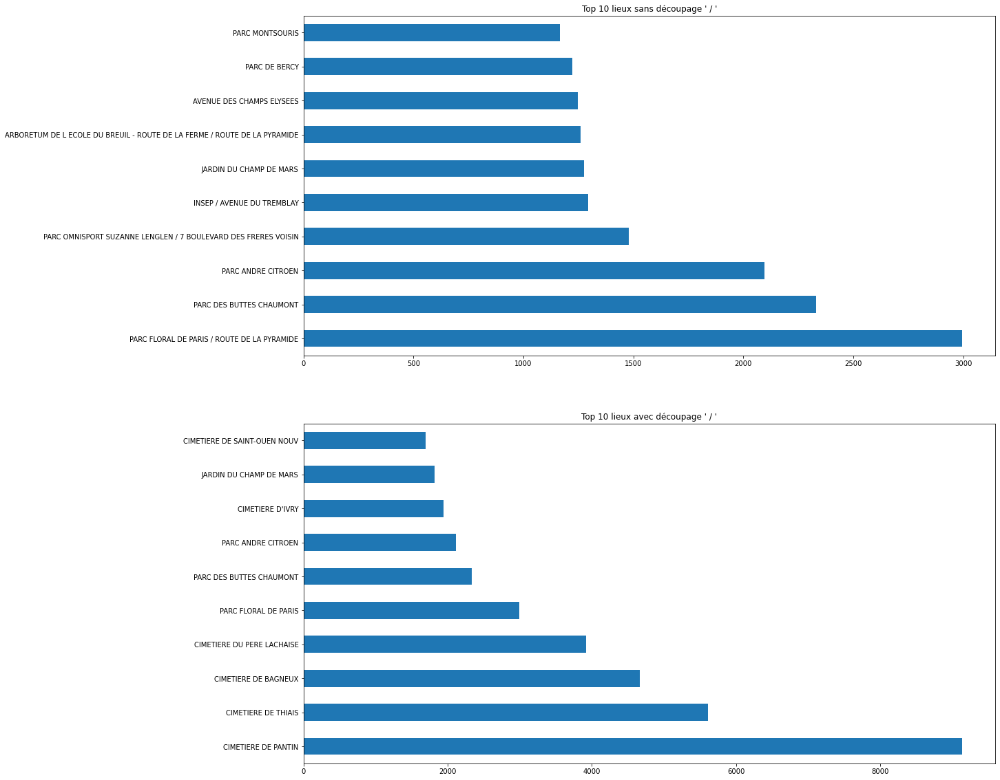

In [ ]:
# Display top 10 values of lieu and lieu_1
fig, (ax1, ax2) = plt.subplots(2, 1, 
    figsize=(18,20),
)

clean_data['lieu'].value_counts().head(10).plot(
    kind='barh', 
    ax=ax1,
    title="Top 10 lieux sans découpage ' / '",
)

clean_data['lieu_1'].value_counts().head(10).plot(
    kind='barh', 
    ax=ax2,
    title="Top 10 lieux avec découpage ' / '",
)

plt.show()

In [ ]:
# Fusion des données minoritaire sous le label "other"
for col in ['lieu', 'lieu_1', 'libelle_francais', 'genre', 'espece', 'variete']:
    freq = clean_data[col].value_counts()
    clean_data['top_'+col] = clean_data[col].where(
        clean_data[col].isna() | clean_data[col].isin(freq.index[:20]), 
        other='Other', 
    )
    

In [ ]:
# Analyse de la logique de l'organisation des catégories
fig = px.parallel_categories(clean_data,
    dimensions=['arrondissement', 'top_lieu_1', 'top_lieu'],
    title="Classification des lieux",
    width=1000,
    height=800,
)
fig.write_image("figures/Classification_des_lieux_coherence.png")
fig.show()

fig = px.parallel_categories(clean_data,
    dimensions=['top_libelle_francais', 'top_genre', 'top_espece', 'top_variete'],
    title="Classification des variétés d'arbres",
    width=1000,
    height=800,
)
fig.write_image("figures/Classification_des_variete_coherence.png")
fig.show()

## II - Analyse des données 

### Quels arbres faut-il mesurer à nouveau ?
Cette partie de notre analyse consiste à identifier les données aberrantes ("outliers") sur la base des mensurations (taille et circonference) des arbres, ainsi que de leur stade de developpement. 
Ces arbres dont les mesuures sont identifiées comme aberrantes par le critère IQR, sont ceux qui doivent être mesurés à nouveau. 

Ainsi seront considérer comme "outliers" , toutes les données de hauteur et de circonference trop éloignées de la norme, ainsi que les valeurs égales à 0.

In [ ]:
# copie des données nettoyées
data = clean_data.copy()

# First, let's consider zeros as NaN
data['circonference_cm'].where(data['circonference_cm'] > 0, inplace=True)
data['hauteur_m'].where(data['hauteur_m'] > 0, inplace=True)

# Let's compute the InterQuartile range in order to identify outliers
quartiles = data[['circonference_cm', 'hauteur_m']].quantile([0.25, 0.75])
iqr = quartiles.loc[0.75]-quartiles.loc[0.25]
limits = pd.DataFrame({
    'circonference_cm': [
        max(0, quartiles.loc[0.25,'circonference_cm'] - 1.5 * iqr['circonference_cm']), # min
        quartiles.loc[0.75,'circonference_cm'] + 1.5 * iqr['circonference_cm'], # max
    ],
    'hauteur_m': [
        max(0, quartiles.loc[0.25,'hauteur_m'] - 1.5 * iqr['hauteur_m']), # min
        quartiles.loc[0.75,'hauteur_m'] + 1.5 * iqr['hauteur_m'], # max
    ]
}, index=['min', 'max'])

display(quartiles, limits)

,circonference_cm,hauteur_m
0.25,45.0,6.0
0.75,123.0,14.0


,circonference_cm,hauteur_m
min,0.0,0.0
max,240.0,26.0


on constate donc qu'un arbre "normal" est caractérisé par :

*   une circonférence comprise entre 0 et 240 cm
*   une hauteur comprise entre 0 et 26 m

### Repartition géographique des arbres "anormaux"
Cette visualisation spatiale de la repartition géographiques des arbres aux dimensions dites "anormales" permet une meilleure planification des tournées de mesures et d'entretien de ces arbres.

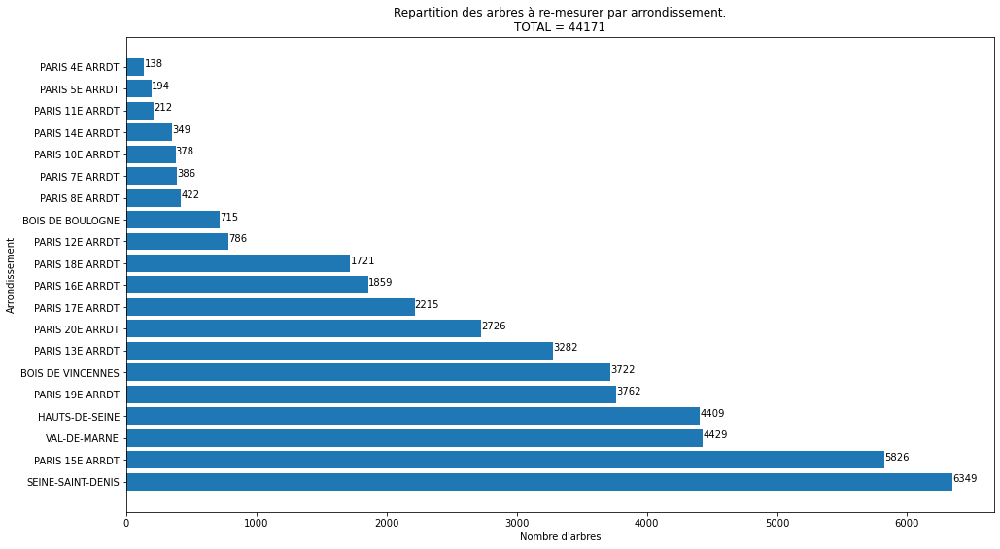

In [ ]:
# Les "outliers" sont les arbres dont la hauteur et la circonference sont en dehors du IQR range
outliers = clean_data[
    ( clean_data['circonference_cm'] <= limits.loc['min','circonference_cm'] )
    | ( clean_data['circonference_cm'] >= limits.loc['max','circonference_cm'] )
    | ( clean_data['hauteur_m'] <= limits.loc['min','hauteur_m'] )
    | ( clean_data['hauteur_m'] >= limits.loc['max','hauteur_m'] )
]

# Distribution des arbres anormaux par arrondissement
count_per_arrondissement = outliers['arrondissement'].value_counts().head(20)

# taille de la figure
plt.figure(figsize=(16,9))

# horizontal bar chart
plt.barh(
    y=count_per_arrondissement.index,
    width=count_per_arrondissement.values,
)

# labels for the value of each bar
for index, value in enumerate(count_per_arrondissement):
    plt.text(y=index , x=value+1 , s=f"{value}")

#  title and labels
plt.xlabel("Nombre d'arbres")
plt.ylabel("Arrondissement")
plt.title(f"Repartition des arbres à re-mesurer par arrondissement.\nTOTAL = { len(outliers) }")

# display the figure
plt.savefig('figures/count_per_arrondissement.png')
plt.show()

### Cartographie spatiale des arbres à re-mesurer

La repartition géographique des 44171 arbres qu'il faudrait mesurer à nouveau est réalisée dans la suite.

In [ ]:
# Display the outliers on a map
fig = px.density_mapbox(outliers, 
    lat='geo_point_2d_a', lon='geo_point_2d_b',
    hover_data=['circonference_cm', 'hauteur_m', 'arrondissement', 'lieu', 'domanialite'],
    radius=2,
    zoom=10,
    mapbox_style="open-street-map",
    title="Carte des arbres à re-mesurer",
    width=1000,
    height=800,
)
fig.write_image("figures/Carte_arbres_remesurer.png")
fig.show()

### Analyse des arbres "normaux"

    Dans l'attente d'une nouvelle mesure des arbres anormaux, les prochaines anlyses ne tiendront pas compte de ces données aberrantes. Pour ce faire, les valeurs aberrantes passe à NaN, puis sont éliminées.

In [ ]:
# les outliers sont passés à la valeur NaN
for col in ['circonference_cm', 'hauteur_m']:
    clean_data[col] = clean_data[col].where(( 
        ( limits.loc['min', col] < clean_data[col] )
        & ( clean_data[col] < limits.loc['max', col] ) 
    ))
    
# Retrait des NaN
clean_data_dropna = clean_data.dropna(subset=['circonference_cm', 'hauteur_m', 'stade_developpement', 'top_libelle_francais'])


### Quels sont les arbres plantés actuellement

    Nous allons travailler sur les données de catégories d'arbes, en se limitant aux valeurs les plus représentatives. Nous allons chercher à observer quel sont les types d'arbres les plus représentés selon leur type, et leur localisation.

In [ ]:
# Visualize repartition of type of trees
freq = clean_data_dropna['top_libelle_francais'].value_counts()
fig = px.pie(freq,
    names=freq.index, 
    values=freq.values,
    title="Classification des arbres par fréquence d'occurence",
)
fig.update_traces(
    textposition='inside',
    textinfo='percent+label'
)
fig.write_image("figures/Classification_arbres_majoritaires.png")
fig.show()

Force est de constater que 4 essences d'abres représentent plus de 50% des arbres plantés. Le matériel et les produits nécessaires à l'enretien des arbres peuvent donc être adaptés grace à cette information. Cette information montre aussi qu'il pourrait y avoir un problème diversité des essences et donc de résilience du parc arboricole de Paris.

### Analyse de la repartition géopgraphique des arbres selon leur espèce

In [ ]:
# repartion des espèces d'arbres par arrondissement
table = clean_data_dropna.pivot_table(
    values='id',
    index='arrondissement',
    columns='top_libelle_francais',
    aggfunc='count',
    observed=True,
)
fig = px.imshow(table,
    title="Repartition des types d'arbre par arrondissement",
    width=1000,
    height=800,
)
fig.write_image("figures/Type_arbre_par_arrondissement.png")
fig.show()

    Il est désormais aisé de constater qu'il y a beaucoup de marronniers dans le 8ème et le 16ème. De même, les platanes sont nombreux dans le 7ème, 12ème,16ème, 17ème, 14ème arrondissement.
    Ces informations permettent de répartir géographiquement et re-dimensionner la taille des équipes et du matériel en fonction des types d'arbres plantés dans chaque arrondissement.

### Repartition des types d'arbres selon leur stade de developpement

In [ ]:
# Repartition des types d'arbres en fonction de leur stade de developpement
table = clean_data_dropna.pivot_table(
    values='id',
    index='stade_developpement',
    columns='top_libelle_francais',
    aggfunc='count',
    observed=True,
)
fig = px.imshow(table,
    title="Type d'arbre par stade de développement",
    width=1000,
    height=400,
)
fig.write_image("figures/Type_arbre_par_stade_developpement.png")
fig.show()

La plupart des platanes et des marronniers sont adultes, puis jeune adultes. Pour tous les autes la repartition est plus homogène. Cette information permet d'optimiser les achats et le stockage du materiel et des produits adaptés spécifiquement à l'entretien de ces arbres.

## Améliorons la gestion des arbres

    Les analyses statistiques et des graphiques constitueront une base pour proposer des pistes d'amélioration de la gestion des arbres de Paris.

### Analyse du developpement des arbres

*   Identification des tendances de developpement normal
*   Identification des arbres présentants des caractéristiques de developpement anormal

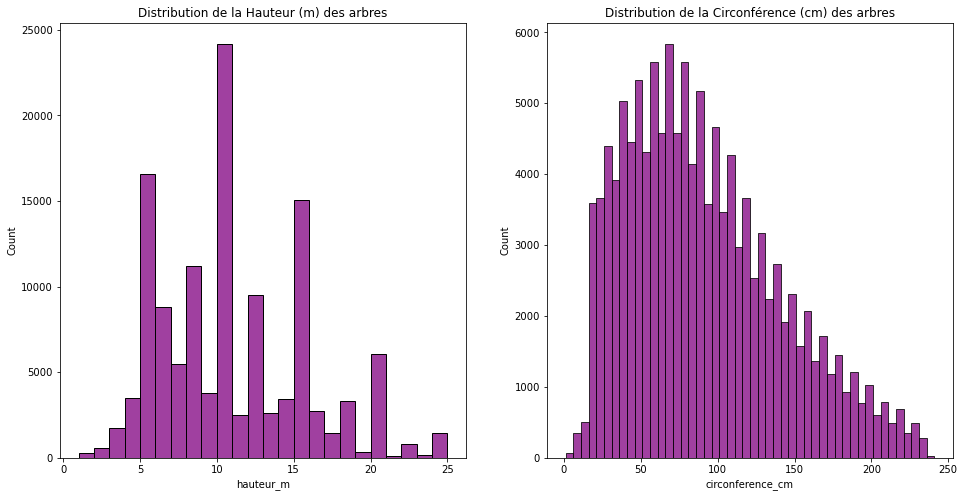

In [ ]:
# Histogrammes of trees height and circumference per development stage
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16,8))
ax1.set_title("Distribution de la Hauteur (m) des arbres")
ax2.set_title("Distribution de la Circonférence (cm) des arbres")

sns.histplot(data=clean_data_dropna, x="hauteur_m", binwidth=1, color="purple", ax=ax1)
sns.histplot(data=clean_data_dropna, x="circonference_cm", binwidth=5, color="purple", ax=ax2)
fig.savefig('figures/Distribution_hauteur_m_circonference_cm.png')

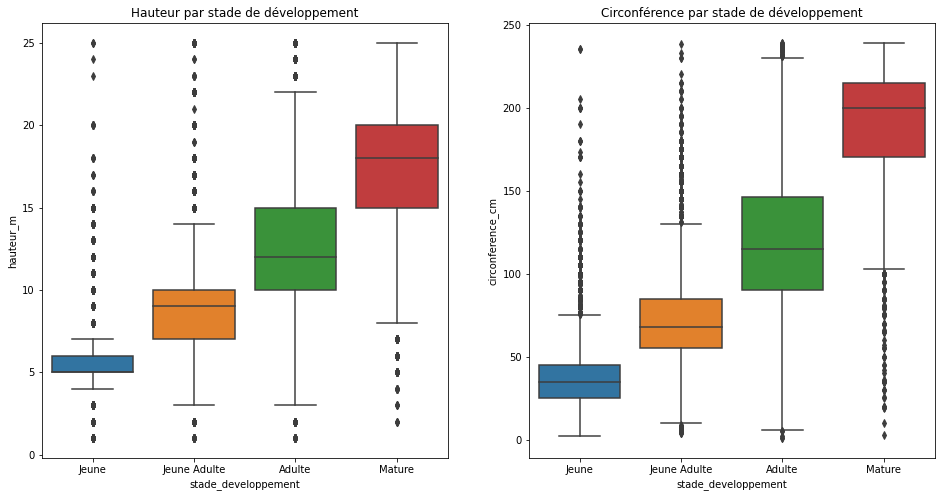

In [ ]:
# Display box plots for trees height and circumference per development stage
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16,8))
ax1.set_title("Hauteur par stade de développement")
ax2.set_title("Circonférence par stade de développement")

sns.boxplot(data=clean_data_dropna,
    x="stade_developpement", 
    y="hauteur_m",
    order=['Jeune', 'Jeune Adulte', 'Adulte', 'Mature'],
    ax=ax1,
)

sns.boxplot(data=clean_data_dropna,
    x="stade_developpement", 
    y="circonference_cm",
    order=['Jeune', 'Jeune Adulte', 'Adulte', 'Mature'],
    ax=ax2,
)
fig.savefig('figures/Distribution_hauteur_m_circonference_cm_par_stade_développement.png')

    Les "outliers" en taille et circonference pour chaque stade de developpent indique qu'il y a des arbres qui ont une taille anormale par rapport à leur stade de développement. D'ou l'importance de contrôler leur santé et leur apporter les soins nécessaires (engrais, arrosage, traitements, ...)
### Analyse Trivariée de la repartition des arbres en fonction de leurs mensuration et stade developpement 

C:\Users\stela\Anaconda3\lib\site-packages\seaborn\axisgrid.py:65: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.

C:\Users\stela\Anaconda3\lib\site-packages\IPython\core\pylabtools.py:132: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



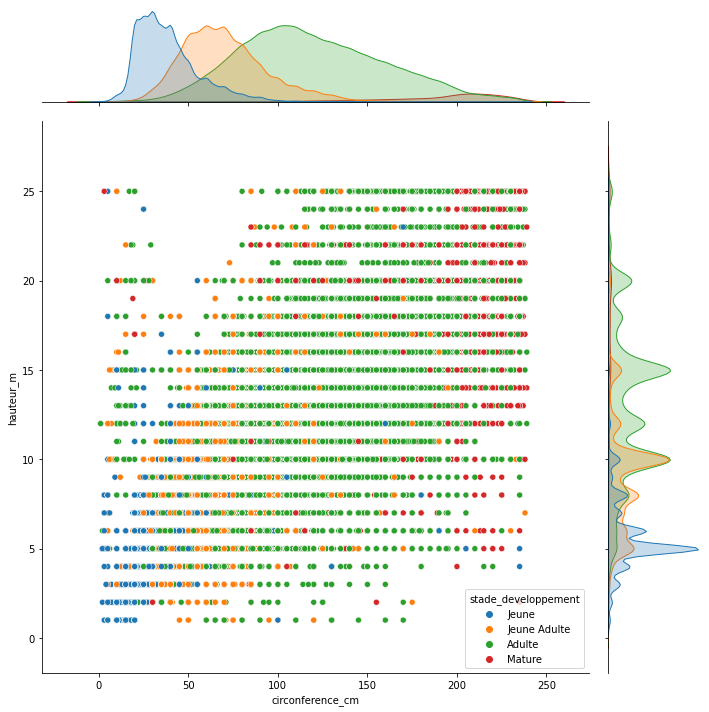

In [ ]:
fig1 = sns.jointplot(data=clean_data_dropna,
    x="circonference_cm", 
    y="hauteur_m", 
    hue="stade_developpement",
    hue_order=['Jeune', 'Jeune Adulte', 'Adulte', 'Mature'],
    height=10,
)
fig1.savefig('figures/jointplot_hauteur_circonference_par_stade_developpement.png')

In [ ]:
#df_clean.to_csv(filepath_transformed01, index=None, header=True,sep=";", encoding='utf-8')


## Cartographie des arbres normaux


In [ ]:
df_mapping = clean_data_dropna[["geo_point_2d_a","geo_point_2d_b","libelle_francais","genre", "espece","circonference_cm", "hauteur_m"]]
df_mapping

,geo_point_2d_a,geo_point_2d_b,libelle_francais,genre,espece,circonference_cm,hauteur_m
1,48.857656,2.321031,If,Taxus,baccata,65.0,8.0
2,48.857705,2.321061,If,Taxus,baccata,90.0,10.0
3,48.857722,2.321006,Erable,Acer,negundo,60.0,8.0
8,48.871990,2.275814,Sophora,Sophora,japonica,145.0,14.0
9,48.872046,2.275752,Sophora,Sophora,japonica,135.0,10.0
...,...,...,...,...,...,...,...
198859,48.890466,2.397443,Peuplier,Populus,tremula,20.0,5.0
198860,48.823919,2.337872,Hêtre,Fagus,sylvatica,55.0,7.0
198861,48.821099,2.338411,If,Taxus,baccata,55.0,5.0
198862,48.823552,2.337892,If,Taxus,baccata,75.0,5.0


In [ ]:
mapping_data_list = df_mapping.values.tolist()

In [ ]:
m1 = folium.Map(location=[48.856614, 2.3522219], zoom_start=11)
callback = ('function (row) {' 
                'var marker = L.marker(new L.LatLng(row[0], row[1]), {color: "red"});'
                'var genre = row[2];'
                'var espece = row[3];'
                'var variete = row[4];'
                'var libelle_francais = row[5];'
                'var circonference = row[6];'
                'var hauteur =  row[7];'
                'var stade_developpement = row[8];'
                'var remarquable = row[9];'
                'var icon = L.AwesomeMarkers.icon({'
                "icon: 'tree-conifer',"
                "iconColor: 'white',"
                "markerColor: 'green',"
                "prefix: 'glyphicon',"
                "extraClasses: 'fa-rotate-0'"
                    '});'
                'marker.setIcon(icon);'
                "var popup = L.popup({maxWidth: '300'});"
                "const display_text = {text: '<table><tbody><tr><td><b>Genre</b></td><td>'+genre+'</td></tr><tr><td><b>Espèce</b></td><td>'+espece+'</td></tr><tr><td><b>Variete</b></td><td>'+variete+'</td></tr><tr><td><b>Libellé</b></td><td>'+libelle_francais+'</td></tr><tr><td><b>Circonférence (cm)</b></td><td>'+circonference+'</td></tr><tr><td><b>Hauteur (m)</b></td><td>'+hauteur+'</td></tr><tr><td><b>Stade</b></td><td>'+stade_developpement+'</td></tr><tr><td><b>Remarquable</b></td><td>'+remarquable+'</td></tr></tbody></table>'};"
                "var mytext = $(`<div id='mytext' class='display_text' style='width: 100.0%; height: 100.0%;'> ${display_text.text}</div>`)[0];"
                "popup.setContent(mytext);"
                "marker.bindPopup(popup);"
                'return marker};')
m1.add_child(FastMarkerCluster(clean_data_dropna[["geo_point_2d_a", 
                                  "geo_point_2d_b", 
                                  "genre", 
                                  "espece", 
                                  "variete",
                                  "libelle_francais", 
                                  "circonference_cm", 
                                  "hauteur_m", 
                                  "stade_developpement", 
                                  "remarquable"]].values.tolist(), 
                              showCoverageOnHover = True,
                              spiderfyOnMaxZoom = False,
                              disableClusteringAtZoom = 18,
                             callback = callback))
m1.save("carte_arbre.html")
m1

## Conclusion

Au terme de cette analyse, il ressort qu'une meilleure repartion géographique des ressources humaines et matérielle est rendue possible par la cartographie des arbres selon leur espèces et leur stade de croissance. Par ailleurs, une information sur la diversité des essences et donc de résilience du parc arboricole de Paris est obtenue. En effet, 4 essences d'arbres représentent plus de 50% des arbres plantés. Il pourrait y avoir un problème diversité des essences et donc de résilience du parc arboricole de Paris. De plus, grâce à cette information, le matériel et les produits nécessaires à l'enretien des arbres peuvent donc être adaptés. 

L'analyse des données a également revélé que 44171 arbres ont été identifiés comme ayant des données aberrantes. Une nouvelle campagne de mesure est donc préconisée. En outre, des informations ont été mis en lumière concernant les arbres dont le stade de crossance est normal, c'est à dire en adéquation avec le stade de developpement, et ceux dont les caractéristiques de hauteur et de circonference sont en decalage avec leur stade de croissance. Les derniers cités ont été cartographiés, car ils ont besoins de soins particulier.